# Train YOLOv8 on Air Hockey Dataset

In [1]:
!nvidia-smi

Sun Nov 19 01:40:22 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 537.34                 Driver Version: 537.34       CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 4090      WDDM  | 00000000:01:00.0  On |                  Off |
|  0%   46C    P5              25W / 500W |   6390MiB / 24564MiB |      8%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
import os
HOME = os.getcwd()
print(HOME)

c:\Users\Ryan Barry\OneDrive - rit.edu\Laptop Backup\Desktop\RIT\Robot Perception\Project\air-hockey-robot\YOLOv8


# Install YOLOv8

In [3]:
!pip install -U ultralytics==8.0.58

from IPython.display import display, Image, clear_output
clear_output()

import ultralytics
ultralytics.checks()

from ultralytics import YOLO

Ultralytics YOLOv8.0.58  Python-3.10.11 torch-2.1.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4090, 24564MiB)
Setup complete  (24 CPUs, 63.8 GB RAM, 1286.4/1862.2 GB disk)


# Download Dataset

In [4]:
!pip install roboflow
clear_output()

from API_KEY import API_KEY

from roboflow import Roboflow
rf = Roboflow(api_key=API_KEY)
project = rf.workspace("airhockeyrobot").project("airhockey-7cphv")
dataset = project.version(2).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.0.58, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to AirHockey-2 in yolov8:: 100%|██████████| 750/750 [00:00<00:00, 5066.91it/s]


# Create yaml file

In [5]:
import yaml

yaml_dict = {'train': f'{HOME}/AirHockey-2/train',   # path to the train folder
            'val': f'{HOME}/AirHockey-2/valid', # path to the val folder
            'nc': 2,                             # number of classes
            'names': ['P', 'T']}                # list of label names

with open(r'air_hockey.yaml', 'w') as file:
    documents = yaml.dump(yaml_dict, file)

# Train YOLOv8n model on Custom Dataset

In [7]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [8]:
!pip install clearml

!clearml-init
clear_output()

from API_KEY import CLEARML_ACCESS, CLEARML_SECRET

%env CLEARML_WEB_HOST=https://app.clear.ml

%env CLEARML_API_HOST=https://api.clear.ml

%env CLEARML_FILES_HOST=https://files.clear.ml

%env CLEARML_API_ACCESS_KEY=CLEARML_ACCESS %env CLEARML_API_SECRET_KEY=CLEARML_SECRET


env: CLEARML_WEB_HOST=https://app.clear.ml
env: CLEARML_API_HOST=https://api.clear.ml
env: CLEARML_FILES_HOST=https://files.clear.ml
env: CLEARML_API_ACCESS_KEY=CLEARML_ACCESS %env CLEARML_API_SECRET_KEY=CLEARML_SECRET


In [19]:
%cd {HOME}
!yolo task=detect mode=train model=yolov8n.pt imgsz=480 data=air_hockey.yaml epochs=1000 batch=8 name=yolov8n_air_hockey workers=0 momentum=0.85 weight_decay=0.0005 device=0 save=True pretrained=True save_json=True save_txt=True

c:\Users\Ryan Barry\OneDrive - rit.edu\Laptop Backup\Desktop\RIT\Robot Perception\Project\air-hockey-robot\YOLOv8


New https://pypi.org/project/ultralytics/8.0.212 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.58  Python-3.10.11 torch-2.1.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4090, 24564MiB)
yolo\engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=air_hockey.yaml, epochs=1000, patience=50, batch=8, imgsz=480, save=True, save_period=-1, cache=False, device=0, workers=0, project=None, name=yolov8n_air_hockey, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=True, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=True, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classe

# View training results

In [2]:

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import pandas as pd

In [3]:
path2m = f'{HOME}/runs/detect/yolov8n_air_hockey19/'

In [4]:
model_df = pd.read_csv(path2m + 'results.csv')

display(model_df)

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,0,1.47430,3.15690,1.58710,0.00241,0.50758,0.49754,0.47902,0.70119,3.03620,0.96987,0.071200,0.003200,0.003200
1,1,0.58906,1.59960,0.94379,0.99341,0.59188,0.92299,0.71369,0.64119,1.48820,0.94921,0.041494,0.006494,0.006494
2,2,0.65136,1.00290,0.92888,0.98956,0.93993,0.97636,0.69303,0.77180,0.93425,1.13690,0.011781,0.009781,0.009781
3,3,0.72635,0.91702,0.94868,0.99344,0.85234,0.97451,0.69159,0.78287,1.17170,0.99732,0.009970,0.009970,0.009970
4,4,0.67110,0.89268,0.95522,0.99313,0.96212,0.97103,0.72819,0.71992,0.76892,0.98707,0.009970,0.009970,0.009970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,93,0.38856,0.34404,0.88378,0.99614,0.99242,0.99023,0.83889,0.46358,0.28503,0.88104,0.009089,0.009089,0.009089
94,94,0.38807,0.35001,0.88053,0.99732,0.99242,0.99030,0.82100,0.48331,0.29457,0.88758,0.009079,0.009079,0.009079
95,95,0.37148,0.35723,0.88456,0.99640,0.99242,0.99022,0.83078,0.50311,0.31161,0.89334,0.009069,0.009069,0.009069
96,96,0.39489,0.36103,0.88185,0.99653,0.99242,0.99082,0.84259,0.46594,0.31843,0.87763,0.009059,0.009059,0.009059


Now to view trends within the dataframe

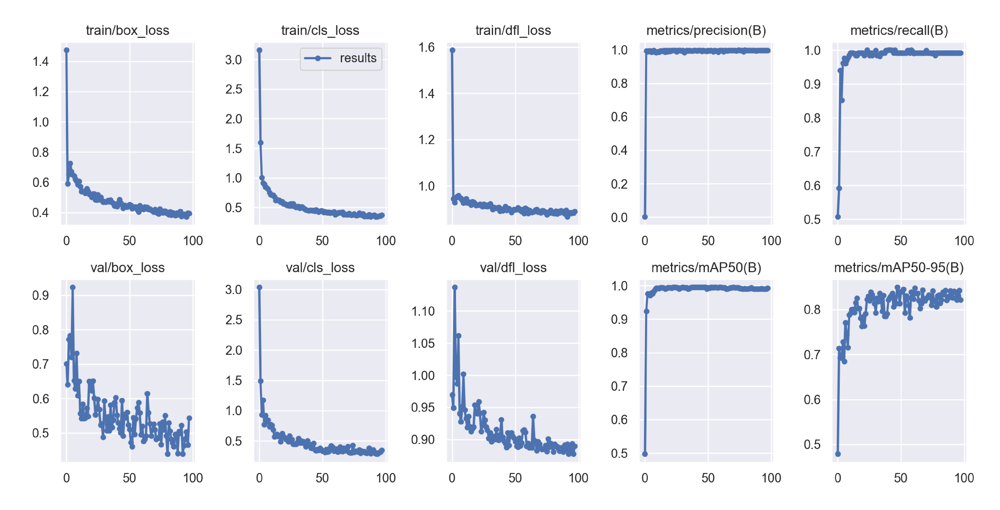

In [5]:
img = mpimg.imread(path2m + 'results.png')

fig = plt.figure(figsize=(12,12), dpi=500)

plt.imshow(img, interpolation='none')
plt.axis('off')
plt.show()

# View P, R, PR, and F1 curves
As we can see from the curves, this YOLO model is able to detect the table and puck at extreme efficiencies.

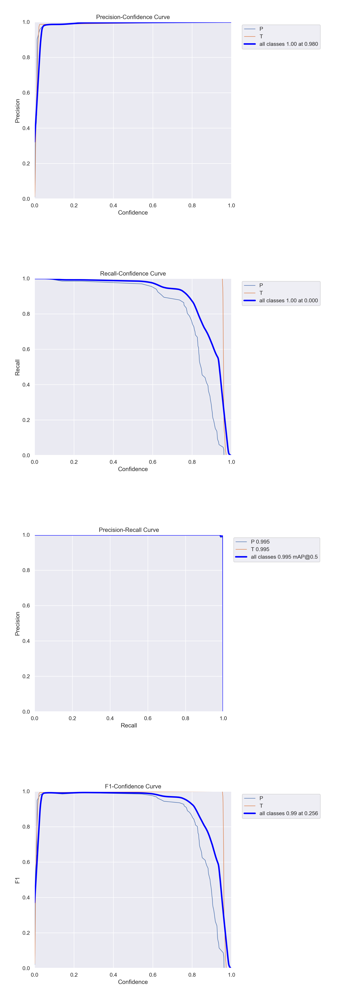

In [7]:
# Load the curve images
p_crv = mpimg.imread(path2m + 'P_curve.png')
r_crv = mpimg.imread(path2m + 'R_curve.png')
pr_crv = mpimg.imread(path2m + 'PR_curve.png')
f1_crv = mpimg.imread(path2m + 'F1_curve.png')

# Create a 2x2 grid of subplots
fig, axs = plt.subplots(4, 1, figsize=(5, 15), dpi=500)

# Display the curves in the subplots
axs[0].imshow(p_crv)
axs[1].imshow(r_crv)
axs[2].imshow(pr_crv)
axs[3].imshow(f1_crv)

# Turn off the axis labels
for ax in axs.flatten():
    ax.axis('off')

# Show the plot
plt.show()

# View Confusion Matrix
The model performs classification correctly almost every time

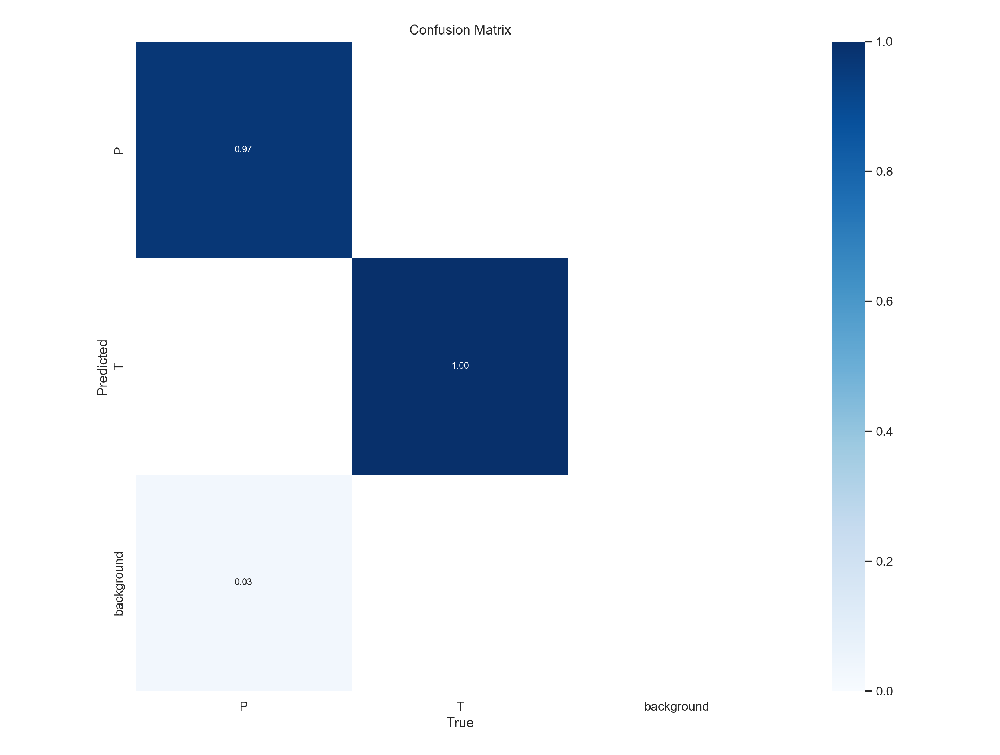

In [6]:
img = mpimg.imread(path2m + 'confusion_matrix.png')

fig = plt.figure(figsize=(12,12), dpi=500)

plt.imshow(img, interpolation='none')
plt.axis('off')
plt.show()

# Display Validation Images
YOLO made predictions on three sets of validation images. They're shown below along with their labeled counterparts

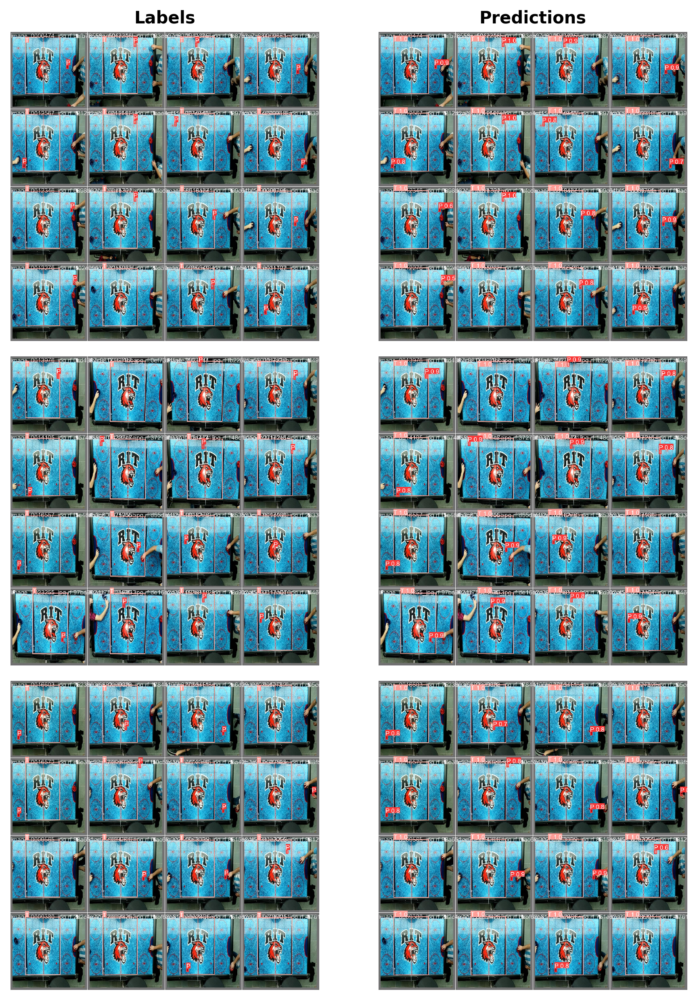

In [12]:
# Define the file locations of the images
img_files = [path2m + 'val_batch0_labels.jpg', path2m + 'val_batch0_pred.jpg',
             path2m + 'val_batch1_labels.jpg', path2m + 'val_batch1_pred.jpg',
             path2m + 'val_batch2_labels.jpg', path2m + 'val_batch2_pred.jpg']

# Load the images into NumPy arrays
images = [mpimg.imread(f) for f in img_files]

# Create a 3x2 grid of subplots
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(8, 10), dpi=250)

# Set the left column to say "Labels" and the right column to say "Predicted"
axes[0, 0].set_title('Labels', fontsize=12, fontweight='bold')
axes[0, 1].set_title('Predictions', fontsize=12, fontweight='bold')


# Plot each image in a subplot
for i, ax in enumerate(axes.flat):
    if i < len(images):
        ax.imshow(images[i], interpolation='none')
    ax.set_axis_off()

# Display the plot
plt.tight_layout()
plt.show()

# Run inference on testing set

In [17]:
!yolo task=detect mode=predict model=runs/detect/yolov8n_air_hockey19/weights/best.pt conf=0.3 source=AirHockey-2/test/images/ save=True save_txt=True

2023-11-19 11:19:32.436745: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.

Ultralytics YOLOv8.0.58  Python-3.10.11 torch-2.1.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4090, 24564MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

image 1/37 C:\Users\Ryan Barry\OneDrive - rit.edu\Laptop Backup\Desktop\RIT\Robot Perception\Project\air-hockey-robot\YOLOv8\AirHockey-2\test\images\image_0000428_jpg.rf.d52d99a71dce74fd99b92e75fc18ad7d.jpg: 480x480 1 P, 1 T, 7.0ms
image 2/37 C:\Users\Ryan Barry\OneDrive - rit.edu\Laptop Backup\Desktop\RIT\Robot Perception\Project\air-hockey-robot\YOLOv8\AirHockey-2\test\images\image_0001569_jpg.rf.b8e8ed1d9b267656b63241424f1e02f8.jpg: 480x480 1 P, 1 T, 5.0ms
image 3/37 C:\Users\Ryan Barry\OneDrive - rit.edu\Laptop Bac

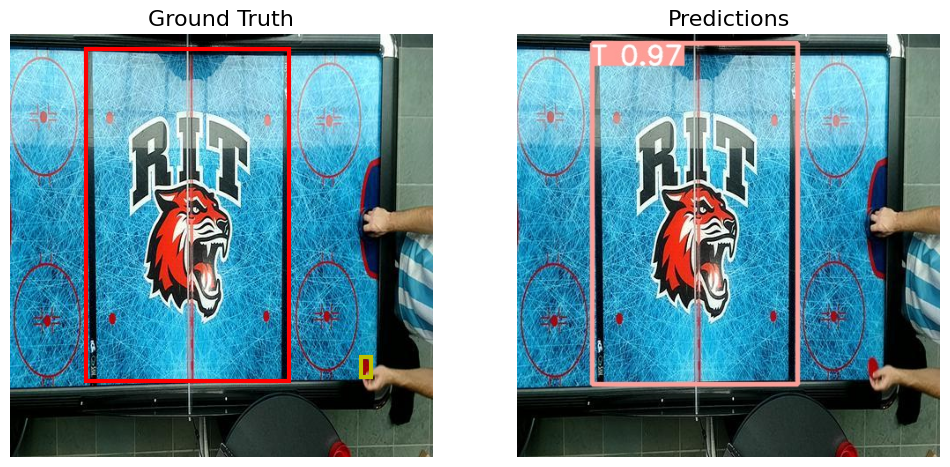

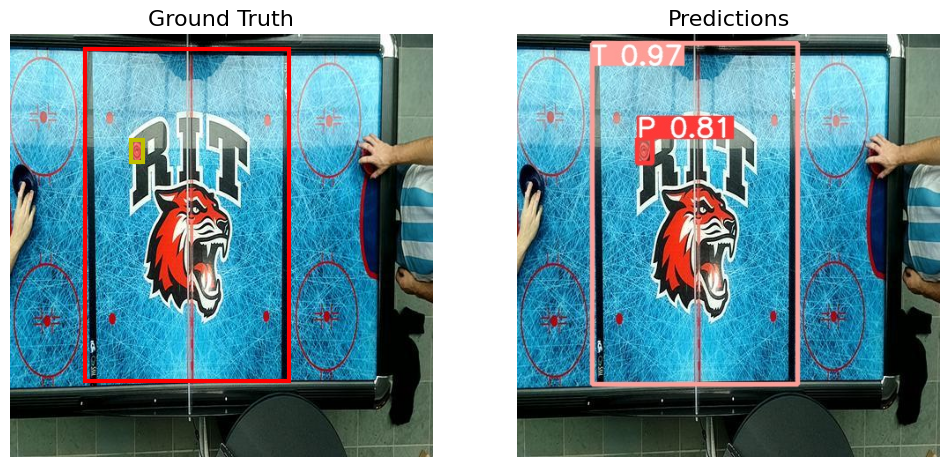

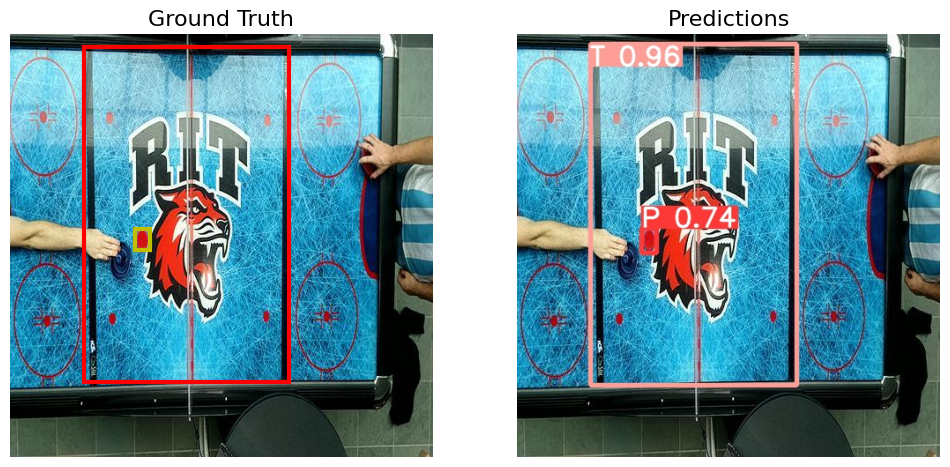

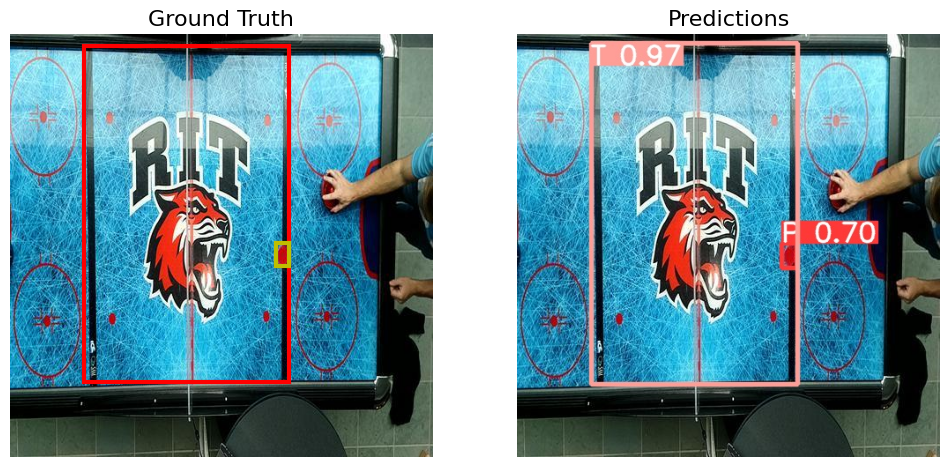

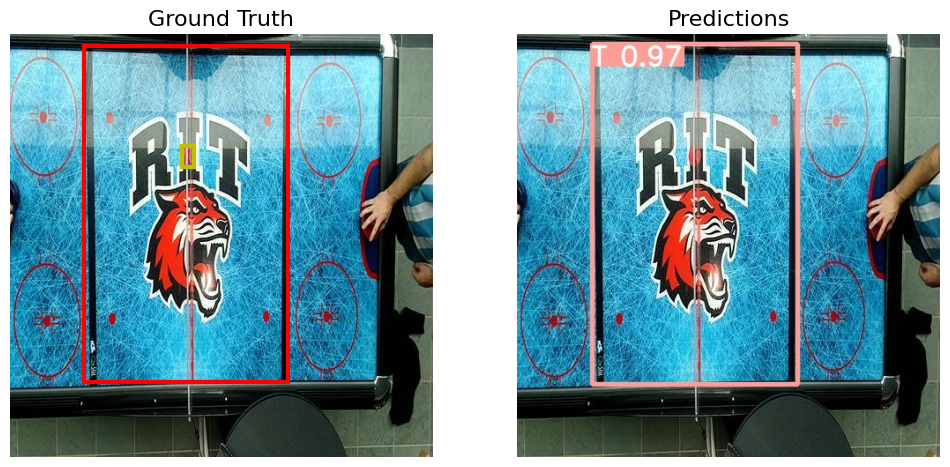

...

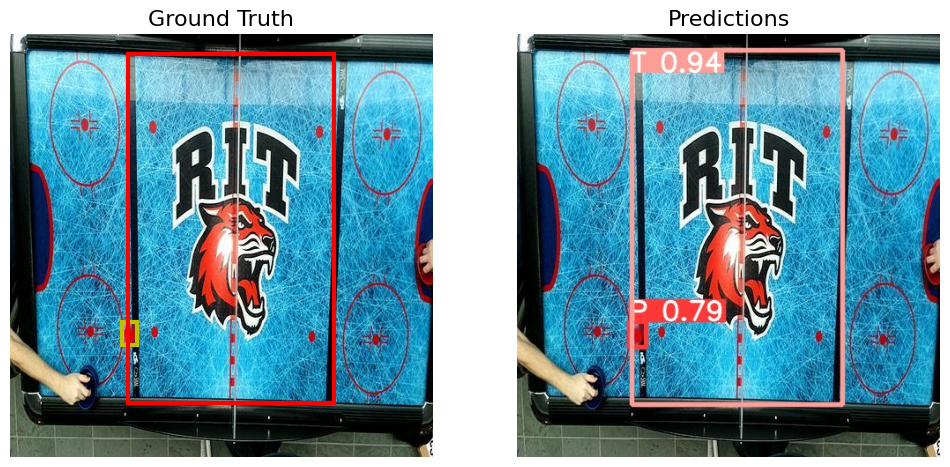

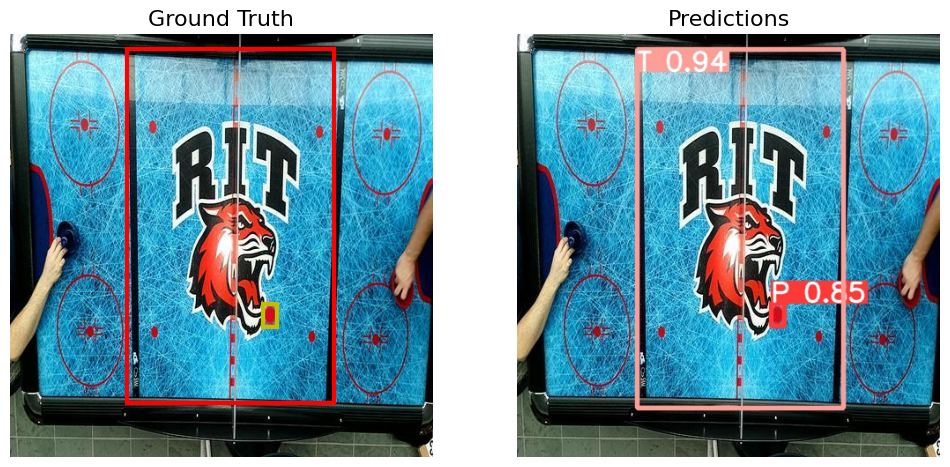

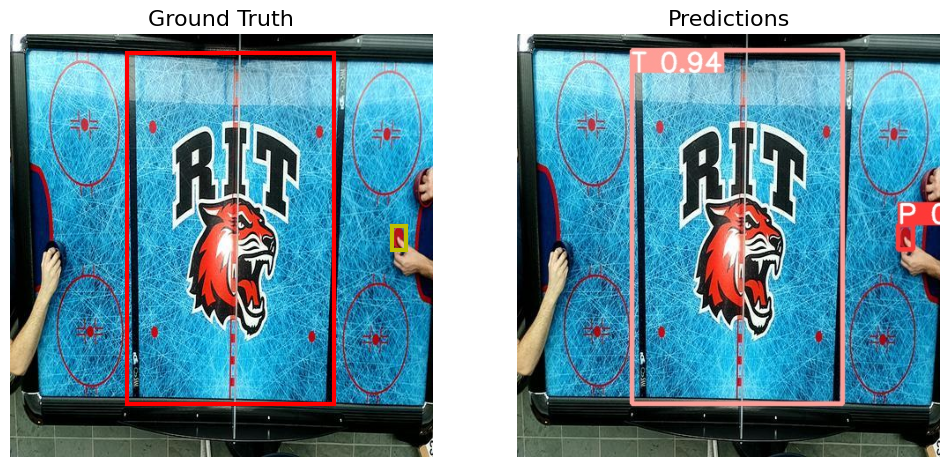

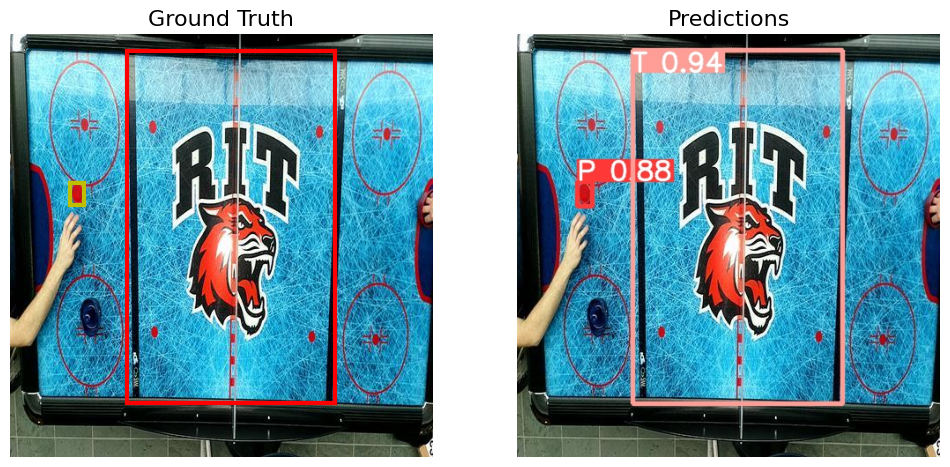

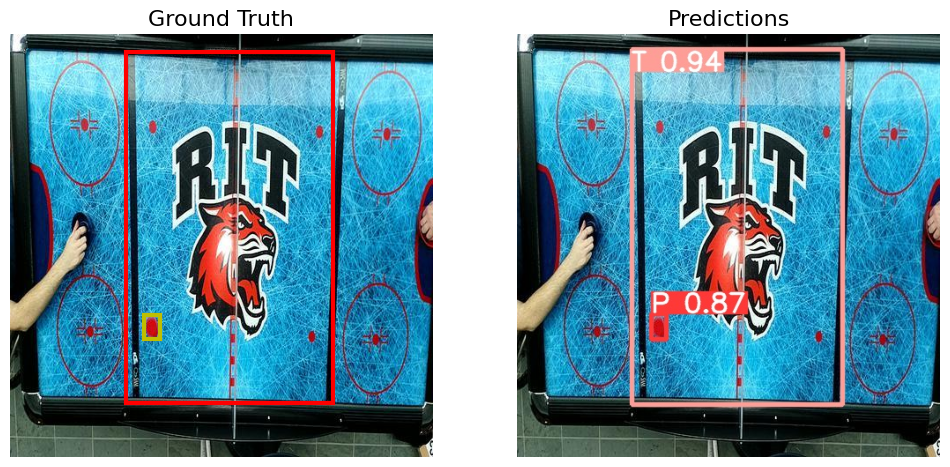

In [24]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import os

DIRECTORY = f"{HOME}/AirHockey-2/test"
PREDICT_DIR = f"{HOME}/runs/detect/predict"

# Get the list of image files in the directory
image_files = os.listdir(f"{DIRECTORY}/images")

# Iterate over each image file
for image_file in image_files:
    # Get the base filename without extension
    file_base = os.path.splitext(image_file)[0]
    # Construct the paths for annotation, image, and predicted label files
    ANNOTATION_FILE = f"{DIRECTORY}/labels/{file_base}.txt"
    IMAGE_FILE = f"{DIRECTORY}/images/{image_file}"
    PREDICTED_LABELS = f"{PREDICT_DIR}/{file_base}.jpg"
    # Read the lines of the annotation file
    with open(ANNOTATION_FILE, "r") as file:
        lines = file.readlines()
    # Store the bounding box coordinates in a list
    bounding_boxes = []
    # Process each line
    for line in lines:
        # Split the line into separate values
        values = line.split()
        # Extract the values
        class_id = int(values[0])
        x = float(values[1])
        y = float(values[2])
        w = float(values[3])
        h = float(values[4])
        # Calculate the coordinates of the top-left and bottom-right corners of the bounding box
        width, height = 480, 480
        x1 = int((x - w/2) * width)
        y1 = int((y - h/2) * height)
        x2 = int((x + w/2) * width)
        y2 = int((y + h/2) * height)
        # Store the bounding box coordinates in the list
        bounding_boxes.append((class_id, x1, y1, x2, y2))
    # Load the image
    image = plt.imread(IMAGE_FILE)
    pred = plt.imread(PREDICTED_LABELS)
    # Create a figure and axis
    fig, axs = plt.subplots(1, 2, figsize=(12, 10))
    # Display the image and annotations in the subplots
    axs[0].imshow(image)
    axs[1].imshow(pred)
    # Iterate over each bounding box
    for box in bounding_boxes:
        class_id, x1, y1, x2, y2 = box
        # Create a Rectangle patch for each bounding box
        if class_id == 0:
            color = 'y'
        elif class_id == 1:
            color = 'r'
        bbox = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=3, edgecolor=color, facecolor='none')
        # Add the bounding box to the plot in the left subplot
        axs[0].add_patch(bbox)
    # Remove the x and y axis ticks from both subplots
    axs[0].axis('off')
    axs[1].axis('off')
    # Add titles to the subplots
    axs[0].set_title('Ground Truth', fontsize=16)
    axs[1].set_title('Predictions', fontsize=16)
    # Show the plot
    plt.show()